In [1]:
import pickle
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
import json
import utm
import geojsoncontour
import plotly.graph_objects as go
import laspy
from tqdm import tqdm
from matplotlib.patches import Circle

Credits to https://www.generic-mapping-tools.org/egu22pygmt/lidar_to_surface.html for the tutorial on pygmt and LiDAR data

In [2]:
radius = 0

In [3]:
# Define conversion functions
def utm_to_latlon(x, y):
    # Convert lat/lon to UTM coordinates
    lat, lon = utm.to_latlon(x, y, 32, 'U')

    return lat, lon

# Define conversion functions
def latlon_to_utm(lat, lon):
    # Convert lat/lon to UTM coordinates
    utm_x, utm_y, _, _ = utm.from_latlon(lat, lon)

    return utm_x, utm_y

In [4]:
# Define the bounding box coordinates in WGS-84
LAT_MIN, LAT_MAX = 50.896393, 50.967115
LON_MIN, LON_MAX = 6.919968, 7.005756

# Minimum Z to consider
Z_MIN = 50

# Subsampling factor for points cloud
SSFACTOR = 4

# Subbox size and grid resolution
box_size = 2000
resolution = 100 # 100 takes 20', 50 takes 80' (4 times more), 20 takes 345'

# Classification to consider
# https://www.bezreg-koeln.nrw.de/brk_internet/geobasis/hoehenmodelle/nutzerinformationen.pdf
lastReturnNichtBoden = 20
brueckenpunkte = 17
class_ok = [brueckenpunkte, lastReturnNichtBoden]


In [6]:
def find_files(bbox_min_x, bbox_max_x, bbox_min_y, bbox_max_y):
       
    bbox_min_x = bbox_min_x - radius
    bbox_min_y = bbox_min_y - radius

    bbox_max_x = bbox_max_x + radius
    bbox_max_y = bbox_max_y + radius

    # Determine the necessary .laz files based on the easting and northing coordinates
    min_easting = int(bbox_min_x) // 1000
    min_northing = int(bbox_min_y) // 1000
    max_easting = int(bbox_max_x) // 1000
    max_northing = int(bbox_max_y) // 1000

    laz_files = []

    for easting in range(min_easting, max_easting + 1):
        for northing in range(min_northing, max_northing + 1):
            filename = f"./lidar_data/3dm_32_{easting:03d}_{northing:04d}_1_nw.laz"
            laz_files.append(filename)

    return laz_files

def load_files(laz_files):

    # Initialize empty arrays for point coordinates and elevations
    x_all = np.array([])
    y_all = np.array([])
    z_all = np.array([])

    for file in laz_files:
        las = laspy.read(file)
        #print('processing %s'%(file))
        x = las.x[::SSFACTOR]
        y = las.y[::SSFACTOR]
        z = las.z[::SSFACTOR]
        class_val = las.classification[::SSFACTOR]

        mask = (np.isin(class_val, class_ok))&(z>=Z_MIN)

        # Stack point coordinates and elevations
        x_all = np.hstack((x_all, x[mask]))
        y_all = np.hstack((y_all, y[mask]))
        z_all = np.hstack((z_all, z[mask]))
    
    return x_all, y_all, z_all

def find_z(x_all, y_all, z_all, x, y):

    # Calculate distance from input point
    distance = np.sqrt((x_all - x)**2 + (y_all - y)**2)

    # Find highest elevation within search radius
    in_radius = distance <= radius
    z_max = np.max(z_all[in_radius])

    return z_max

def create_surface(x_min, x_max, y_min, y_max, resolution, x_all, y_all, z_all):

    # Create 1D arrays of X and Y coordinates
    x = np.arange(x_min, x_max, resolution)
    y = np.arange(y_min, y_max, resolution)

    # Create 2D arrays of X and Y coordinates
    xx, yy = np.meshgrid(x, y)

    # Calculate Z values using user-defined function find_z(x, y)
    zz = np.zeros_like(xx)
    for i in tqdm(range(xx.shape[0])):
        for j in range(xx.shape[1]):
            zz[i, j] = find_z(x_all, y_all, z_all, xx[i, j], yy[i, j])

    return x, y, zz

In [7]:
bbox_min_x, bbox_min_y = latlon_to_utm(LAT_MIN, LON_MIN)
bbox_max_x, bbox_max_y = latlon_to_utm(LAT_MAX, LON_MAX)

x_edges = []
y_edges = []

x_edges = np.arange(bbox_min_x, bbox_max_x,  box_size)
x_edges = np.append(x_edges, bbox_max_x)

y_edges = np.arange(bbox_min_y, bbox_max_y,  box_size)
y_edges = np.append(y_edges, bbox_max_y)

x_len = len(x_edges)
y_len = len(y_edges)

x_all = np.array([])
y_all = np.array([])
z_all = np.array([])

print('x_len: %s, y_len: %s, number of boxes: %s'%(str(x_len), str(y_len), str((x_len-1)*(y_len-1))))

cols, rows = (x_len-1, y_len-1)

# Initialise 2D lists (which will contain arrays and not scalar, so 2D np array does not work here)
x_results = [[0 for i in range(cols)] for j in range(rows)]
y_results = [[0 for i in range(cols)] for j in range(rows)]
z_results = [[0 for i in range(cols)] for j in range(rows)]

# iterate on subboxes
for i in range(x_len - 1): # subboxes along x axis (longitude)
    for j in range(y_len - 1): # subboxes along y axis (latitude)

        laz_files = find_files(x_edges[i], x_edges[i+1], y_edges[j], y_edges[j+1])

        x_all_temp, y_all_temp, z_all_temp = load_files(laz_files)

        x_all = np.concatenate((x_all, x_all_temp))
        y_all = np.concatenate((y_all, y_all_temp))
        z_all = np.concatenate((z_all, z_all_temp))

x_len: 5, y_len: 5, number of boxes: 16


In [8]:
df = pd.DataFrame(
    data={
        "x": x_all,
        "y": y_all,
        "z": z_all
    }
)

In [9]:
# Print summary statistics
print(f"Total of {len(df)} data points")
df.describe()

Total of 68466059 data points


,x,y,z
count,6.846606e+07,6.846606e+07,6.846606e+07
mean,3.563355e+05,5.644390e+06,5.988658e+01
std,1.920708e+03,2.238237e+03,7.938929e+00
min,3.530000e+05,5.640000e+06,5.000000e+01
25%,3.550000e+05,5.642570e+06,5.388000e+01
50%,3.559855e+05,5.644476e+06,5.874000e+01
75%,3.577465e+05,5.646195e+06,6.435000e+01
max,3.600000e+05,5.649000e+06,3.119000e+02


In [10]:
df_filtered = df.iloc[::200]
print(f"Filtered down to {len(df_filtered)} data points")

Filtered down to 342331 data points


In [11]:
import pygmt

# Get bounding box region
region = pygmt.info(data=df[["x", "y"]], spacing=1)  # West, East, South, North
print(f"Data points covers region: {region}")

Data points covers region: [ 353000.  360000. 5640000. 5649000.]


In [13]:
# Plot XYZ points on a map
fig = pygmt.Figure()
fig.basemap(frame=True, region=region, projection="x1:5000")
pygmt.makecpt(cmap="bukavu", series=[df.z.min(), df.z.max()])
fig.plot(
    x=df_filtered.x, y=df_filtered.y, color=df_filtered.z, style="c0.03c", cmap=True
)
fig.colorbar(position="JMR", frame=["af+lElevation", "y+lm"])
fig.show()

/var/folders/v_/0jkxx12x7r9_3szb050fks9m0000gn/T/ipykernel_35204/3897027719.py:5: FutureWarning: The 'color' parameter has been deprecated since v0.8.0 and will be removed in v0.12.0. Please use 'fill' instead.
  fig.plot(


In [14]:
# Preprocess LiDAR data using blockmedian
df_trimmed = pygmt.blockmedian(
    data=df[["x", "y", "z"]],
    T=0.99,  # 99th quantile, i.e. the highest point
    spacing="1+e",
    region=region,
)
df_trimmed

,x,y,z
0,353050.25,5648999.87,50.87
1,353051.35,5648999.94,50.82
2,353052.82,5648999.58,53.97
3,353055.04,5648999.69,50.78
4,353058.02,5648999.95,54.31
...,...,...,...
18402553,359092.37,5640000.50,61.28
18402554,359092.77,5640000.18,59.11
18402555,359095.87,5640000.35,52.25
18402556,359098.01,5640000.15,52.50


In [15]:
# Create a Digital Surface Elevation Model with
# a spatial resolution of 1m.
grid = pygmt.surface(
    x=df_trimmed.x,
    y=df_trimmed.y,
    z=df_trimmed.z,
    spacing="10+e",
    region=region,  # xmin, xmax, ymin, ymax
    T=0.35,  # tension factor
)

surface [WARNING]: 17934782 unusable points were supplied; these will be ignored.
surface [WARNING]: You should have pre-processed the data with block-mean, -median, or -mode.
surface [WARNING]: Check that previous processing steps write results with enough decimals.
surface [WARNING]: Possibly some data were half-way between nodes and subject to IEEE 754 rounding.


In [29]:
grid

<xarray.DataArray 'z' (y: 901, x: 701)>
array([[ 57.22    ,  53.52902 ,  57.425686, ...,  50.298183,  50.287094,
         50.275467],
       [106.6283  ,  97.24    ,  71.201355, ...,  50.30419 ,  50.292503,
         50.280346],
       [ 96.064896,  90.78272 ,  61.390785, ...,  50.312874,  50.3003  ,
         50.287384],
       ...,
       [ 54.285625,  54.297318,  54.251408, ...,  54.500565,  53.740406,
         52.804516],
       [ 54.35    ,  54.31    ,  54.32    , ...,  54.780407,  54.212585,
         52.95797 ],
       [ 50.55253 ,  52.10989 ,  51.180904, ...,  54.232803,  53.77878 ,
         52.55995 ]], dtype=float32)
Coordinates:
  * x        (x) float64 3.53e+05 3.53e+05 3.53e+05 ... 3.6e+05 3.6e+05 3.6e+05
  * y        (y) float64 5.64e+06 5.64e+06 5.64e+06 ... 5.649e+06 5.649e+06
Attributes:
    long_name:     z
    actual_range:  [ 21.82150269 243.53822327]

In [28]:
fig2 = pygmt.Figure()
fig2.basemap(
    frame=True,
    region=[353_000, 360_000, 5_640_000, 5_649_000],  # [ 353000.  360000. 5640000. 5649000.]
    projection="x1:5000",
)
pygmt.makecpt(cmap="batlow", series=[50, 80])  # series=[df.z.min(), df.z.max()]  series=[-10, 200]
fig2.grdimage(grid=grid, cmap=True)
fig2.colorbar(position="JMR", frame=["af+lElevation", "y+lm"])
fig2.show()

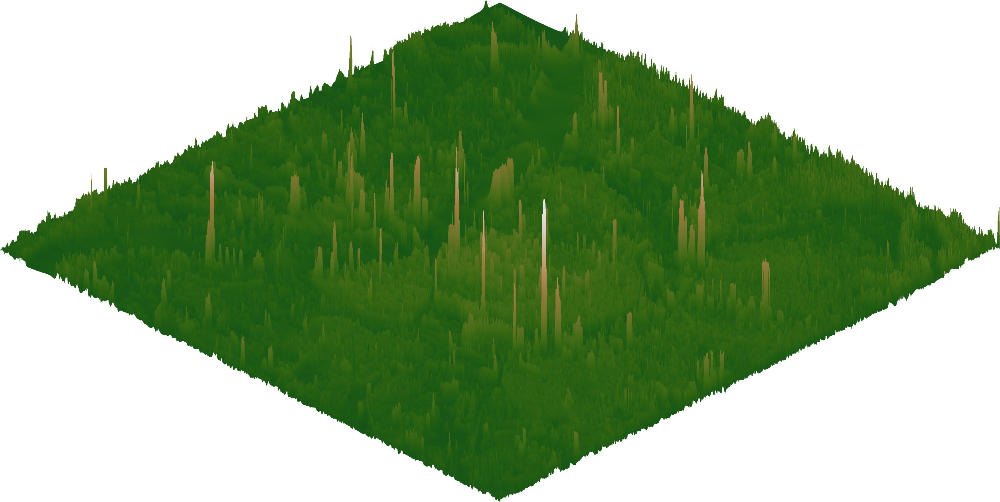

In [17]:
fig3 = pygmt.Figure()
fig3.grdview(
    grid=grid,
    cmap="bukavu",
    surftype="s",  # surface plot
    perspective=[315, 30],  # azimuth bearing, and elevation angle
    zscale=0.02,  # vertical exaggeration
)
fig3.show()

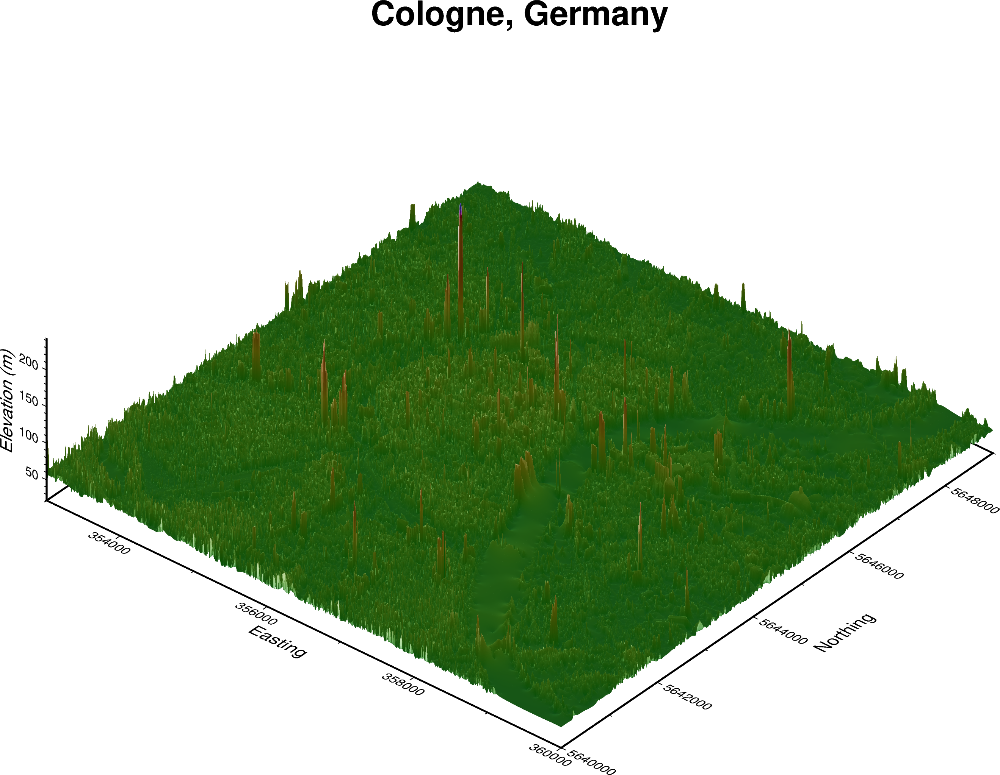

In [22]:
fig3 = pygmt.Figure()
fig3.grdview(
    grid=grid,
    cmap="bukavu",
    surftype="s",  # surface plot
    perspective=[140, 30],  # azimuth bearing, and elevation angle
    zscale=0.01,  # vertical exaggeration
    shading=True,  # hillshading
    frame=[
        "xaf+lEasting",
        "yaf+lNorthing",
        "zaf+lElevation (m)",
        "+tCologne, Germany",
    ],
)
fig3.show()

In [31]:
import rioxarray

grid.rio.to_raster(raster_path="DSM_of_Cologne.tif")